In [1]:
import anndata as ad
import scanpy as sc
import pandas as pd
import polars as pl
import pandas as pd
import os


from sklearn.datasets import load_breast_cancer, load_diabetes, load_iris
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import (
    accuracy_score,
    mean_absolute_error,
    mean_squared_error,
    root_mean_squared_error,
    r2_score,
    roc_auc_score,
)
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.inspection import DecisionBoundaryDisplay

from sklearn.datasets import fetch_openml
from sklearn.preprocessing import LabelEncoder
from IPython.display import display, Markdown, Latex

# Baseline Imports
from xgboost import XGBClassifier, XGBRegressor
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor

import torch

from tabpfn import TabPFNClassifier, TabPFNRegressor
import seaborn as sns
if not torch.cuda.is_available():
    raise SystemError('GPU device not found. For fast training, please enable GPU. See section above for instructions.')

In [2]:
from anndata import ImplicitModificationWarning
import warnings
warnings.filterwarnings("ignore", category=ImplicitModificationWarning)

In [ ]:
    #df1_scaled = df1.assign(**{col: scaler.fit_transform(df1[[col]])[:, 0] for col in df1.columns if col not in ["Unnamed: 0", "label", "batch_id", "encoded_label", "Batch nr", "SMILES"]})


In [3]:
def scale_and_merge(
    df1, 
    df2, 
    merge_key="SMILES", 
    plot=False, 
    vmin=None, 
    vmax=None, 
    merging_mode="individual",
    scaling_method="standard"
):
    """
    Scales and merges df1 and df2 on `merge_key`. Optionally plots before & after
    histograms of up to 3 features from each DataFrame. 

    You can choose how to scale via `merging_mode`:
      - "individual": scale df1 and df2 separately, then merge (original approach)
      - "together":   merge first, then scale all chosen features together

    You can choose how to scale via `scaling_method`:
      - "standard": StandardScaler (zero mean, unit variance)
      - "minmax":   MinMaxScaler (0 to 1 range)
    """

    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.preprocessing import StandardScaler, MinMaxScaler

    # ------------------
    # SELECT THE SCALER
    # ------------------
    if scaling_method == "standard":
        def make_scaler():
            return StandardScaler()
    elif scaling_method == "minmax":
        def make_scaler():
            return MinMaxScaler()
    else:
        raise ValueError(f"Unsupported scaling_method '{scaling_method}'. "
                         "Use 'standard' or 'minmax' or extend as needed.")

    # Identify feature columns in df1
    if any("feature" in col.lower() for col in df1.columns):
        features_df1 = [col for col in df1.columns if "feature" in col.lower()]
    else:
        exclude_cols = ["Unnamed: 0", "label", "batch_id", "encoded_label", "Batch nr", merge_key]
        features_df1 = [col for col in df1.columns if col not in exclude_cols]
    features_df1 = features_df1[:3]  # limit to first 3

    # Identify feature columns in df2
    features_df2 = [col for col in df2.columns if "Feature" in col][:3]

    # ------------------------------------
    # CHOOSE HOW WE MERGE & SCALE (MODE)
    # ------------------------------------
    if merging_mode == "individual":
        # 1) Scale df1 individually
        scaler1 = make_scaler()
        df1_scaled = df1.assign(**{
            col: scaler1.fit_transform(df1[[col]])[:, 0] for col in features_df1
        })

        # 2) Scale df2 individually
        scaler2 = make_scaler()
        df2_scaled = df2.assign(**{
            col: scaler2.fit_transform(df2[[col]])[:, 0] for col in features_df2
        })

        # 3) Merge the scaled DataFrames
        merged_df = df1_scaled.reset_index().merge(df2_scaled, on=merge_key, how="left")
        
        # For plotting, keep references to unscaled data
        df1_unscaled = df1
        df2_unscaled = df2
        df1_final    = df1_scaled
        df2_final    = df2_scaled

    elif merging_mode == "together":
        # 1) Merge first, unscaled
        merged_unscaled = df1.reset_index().merge(df2, on=merge_key, how="left")
        
        # 2) Collect the feature columns from both
        #    (Make sure they all exist in the merged DataFrame)
        all_features = []
        for col in features_df1:
            if col in merged_unscaled.columns:
                all_features.append(col)
        for col in features_df2:
            if col in merged_unscaled.columns and col not in all_features:
                all_features.append(col)

        # 3) Scale those features all at once
        merged_scaled = merged_unscaled.copy()
        scaler = make_scaler()
        merged_scaled[all_features] = scaler.fit_transform(merged_unscaled[all_features])

        # This is our final merged DataFrame
        merged_df = merged_scaled

        # For plotting, keep references to original & final
        df1_unscaled = df1.set_index(merge_key)
        df2_unscaled = df2.set_index(merge_key)

        # We'll slice them out of merged_unscaled/merged_scaled for "before & after"
        df1_final = merged_scaled.set_index(merge_key)
        df2_final = merged_scaled.set_index(merge_key)

    else:
        raise ValueError("merging_mode must be either 'individual' or 'together'.")

    # --------------------------------
    # OPTIONAL PLOTTING
    # --------------------------------
    if plot:
        import numpy as np

        # Figure out how many columns to plot (up to 3 from each)
        ncols = max(len(features_df1), len(features_df2))
        
        fig, axes = plt.subplots(2, ncols, figsize=(ncols * 4, 8), dpi=120)
        sns.set_style("whitegrid")

        # Define color palette: blue for original, orange for scaled
        colors = ["#1f77b4", "#ff7f0e"]

        def plot_histogram(ax, original_data, scaled_data, title):
            sns.histplot(original_data, ax=ax, kde=True, bins=20,
                         color=colors[0], label="Original", alpha=0.8,
                         edgecolor="black", stat="density")
            sns.histplot(scaled_data, ax=ax, kde=True, bins=20,
                         color=colors[1], label="Scaled", alpha=0.6,
                         edgecolor="black", stat="density")

            ax.set_title(title, fontsize=12, fontweight="bold")
            ax.set_xlabel("Feature Value", fontsize=10)
            ax.set_ylabel("", fontsize=10)
            ax.legend(fontsize=9)
            ax.grid(True, linestyle="--", alpha=0.6)

            # Convert y-axis tick labels to percentages
            yticks = ax.get_yticks()
            ax.set_yticklabels([f"{int(y * 100)}%" for y in yticks])

            # Apply vmin and vmax if provided
            if vmin is not None or vmax is not None:
                ax.set_xlim(vmin, vmax)

        # --- Plot top row: df1 features ---
        for i, col in enumerate(features_df1):
            if i >= ncols:
                break
            if merging_mode == "individual":
                original_data = df1_unscaled[col]
                scaled_data   = df1_final[col]
            else:
                # indexing by merge_key
                original_data = df1_unscaled[col] if col in df1_unscaled.columns else []
                scaled_data   = df1_final[col]     if col in df1_final.columns else []

            plot_histogram(
                axes[0, i], 
                original_data, 
                scaled_data,
                f"DF1 - {col} Before & After Scaling"
            )

        # --- Plot bottom row: df2 features ---
        for i, col in enumerate(features_df2):
            if i >= ncols:
                break
            if merging_mode == "individual":
                original_data = df2_unscaled[col]
                scaled_data   = df2_final[col]
            else:
                original_data = df2_unscaled[col] if col in df2_unscaled.columns else []
                scaled_data   = df2_final[col]     if col in df2_final.columns else []

            plot_histogram(
                axes[1, i],
                original_data,
                scaled_data,
                f"DF2 - {col} Before & After Scaling"
            )

        plt.tight_layout()
        plt.show()

    return merged_df


In [4]:
import anndata as ad

def create_anndata(df):
    """
    Creates an AnnData object after dropping duplicates based on specific columns.
    
    Drops duplicates using 'encoded_label', 'batch:uid', and all columns containing 'Feature'.
    
    Parameters:
    - df: DataFrame containing feature and metadata columns
    
    Returns:
    - AnnData object with feature columns as X and metadata as obs
    """
    # Identify feature columns (columns containing "Feature")
    feature_cols = [col for col in df.columns if "Feature" in col]

    # Identify metadata columns for dropping duplicates
    drop_subset = ['encoded_label', 'batch_id'] + feature_cols

    # Drop duplicates based on these columns
    df = df.drop_duplicates(subset=drop_subset)

    # Select only feature columns for X
    X = df[feature_cols].to_numpy()

    # Select metadata columns (excluding features)
    metadata_cols = [col for col in df.columns if col not in feature_cols]
    obs = df[metadata_cols]

    # Create AnnData object
    return ad.AnnData(X=X, obs=obs)




## Load data

In [5]:
smiles = pd.read_csv("/home/jovyan/share/data/analyses/PLP/Compounds/SMILES_5K_meta.csv")

In [11]:
#dp_image_features = pd.read_csv("/home/jovyan/share/data/analyses/PLP/multimodal/data/deepprofiler_features_significant_well.csv")
dp_image_features = pd.read_csv("/home/jovyan/share/data/analyses/PLP/multimodal/data/deepprofiler_NONORM_significant_well.csv")
dp_image_features = dp_image_features.merge(smiles[["Batch nr", "SMILES"]], left_on = "batch_id", right_on = "Batch nr")

In [92]:
feats_dp = merged_data_chemberta_norm[
    [feat for feat in merged_data_chemberta_norm.columns 
     if "feature" in feat or feat in ["encoded_label", "batch_id"]]
]
feats_dp["batch_id"] = feats_dp["batch_id"].astype(str)


/tmp/ipykernel_297296/251606951.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  feats_dp["batch_id"] = feats_dp["batch_id"].astype(str)


In [105]:
smiles_dp = merged_data_chemberta_norm[["SMILES", "encoded_label", "batch_id"]]


In [107]:
smiles_dp.to_csv("deepprofiler_SMILES_minmax_significant.csv")

In [7]:
cp_image_features = pd.read_csv("/home/jovyan/share/data/analyses/PLP/multimodal/data/cellprofiler_features_significant_well.csv")
cp_image_features = cp_image_features.merge(smiles[["Batch nr", "SMILES"]], left_on = "batch_id", right_on = "Batch nr")

In [8]:
cp_features = [col for col in cp_image_features.columns if col not in ["Unnamed: 0", "label", "batch_id", "encoded_label", "Batch nr", "SMILES"]]

In [13]:
chemberta_feats = pd.read_csv("/home/jovyan/share/data/analyses/PLP/Compounds/chemberta_specs5k_features.csv")
molt5_feats = pd.read_csv("/home/jovyan/share/data/analyses/PLP/Compounds/molt5_specs5k_features.csv")

In [14]:
merged_data_chemberta = dp_image_features.reset_index().merge(chemberta_feats, on="SMILES", how='left')
merged_data_molt5_feats = dp_image_features.reset_index().merge(molt5_feats, on="SMILES", how='left')

In [22]:
merged_data_chemberta_CP = cp_image_features.reset_index().merge(chemberta_feats, on="SMILES", how='left')
merged_data_molt5_feats_CP = cp_image_features.reset_index().merge(molt5_feats, on="SMILES", how='left')

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_297296/1390978366.py:141: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([f"{int(y * 100)}%" for y in yticks])
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future ve

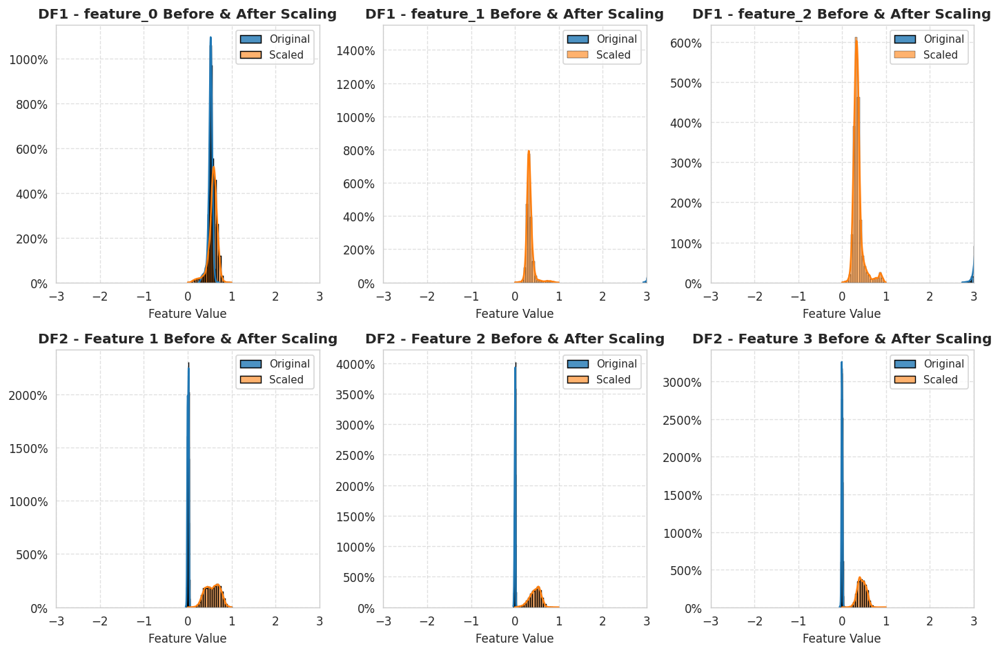

In [50]:
merged_data_chemberta_norm = scale_and_merge(dp_image_features, chemberta_feats, merging_mode = "together",scaling_method = "minmax")
merged_data_molt5_norm = scale_and_merge(dp_image_features, molt5_feats, plot = True, vmin = - 3, vmax = 3, merging_mode = "together",scaling_method = "minmax")

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_297296/1390978366.py:141: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([f"{int(y * 100)}%" for y in yticks])
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future ve

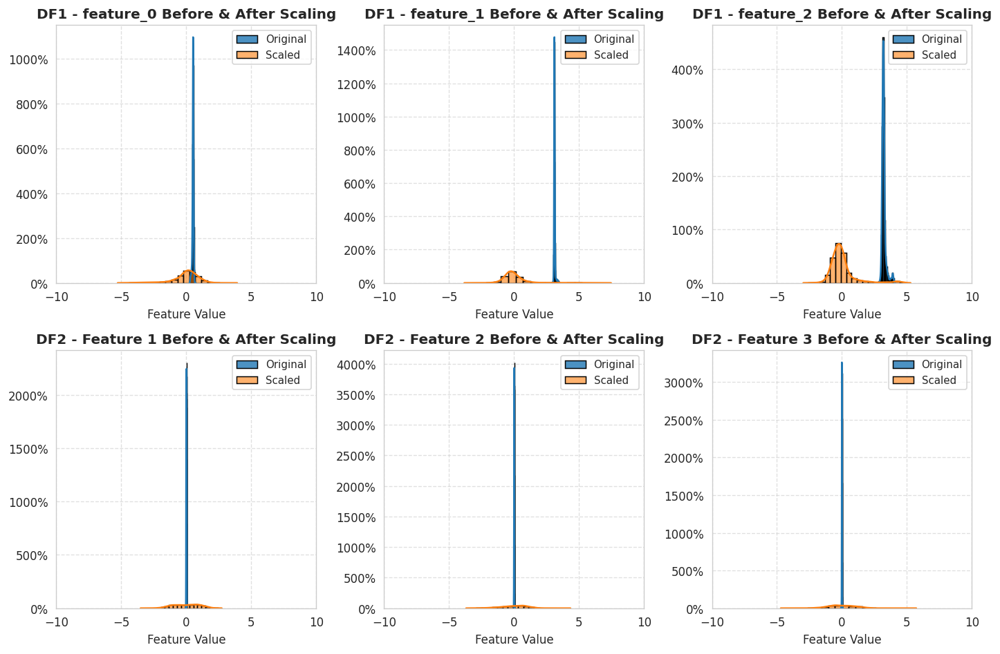

In [28]:
merged_data_chemberta_scaled = scale_and_merge(dp_image_features, chemberta_feats, merging_mode = "together")
merged_data_molt5_scaled = scale_and_merge(dp_image_features, molt5_feats, plot = True, vmin = - 10, vmax = 10, merging_mode = "together")

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_242672/937251307.py:114: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([f"{int(y * 100)}%" for y in yticks])
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future ver

/tmp/ipykernel_242672/937251307.py:114: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([f"{int(y * 100)}%" for y in yticks])
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_242672/937251307.py:114: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_ytickl

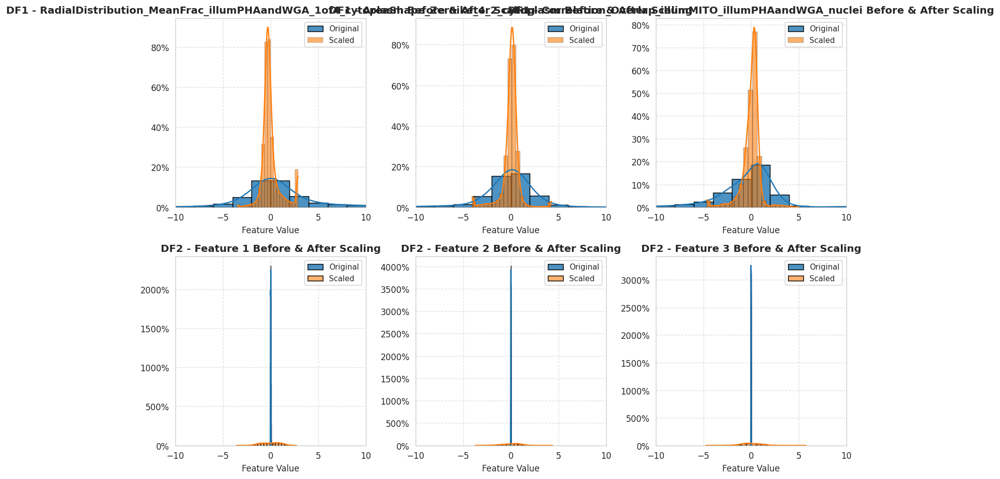

In [12]:
merged_data_chemberta_scaled_CP = scale_and_merge(cp_image_features, chemberta_feats, merging_mode = "together")
merged_data_molt5_scaled_CP = scale_and_merge(cp_image_features, molt5_feats, plot = True, vmin = -10, vmax = 10, merging_mode = "together")

In [24]:
adata_dp = ad.AnnData(X = dp_image_features[[feat for feat in dp_image_features.columns if "feature" in feat]], obs = dp_image_features[[feat for feat in dp_image_features.columns if "feature" not in feat]])
adata_cp = ad.AnnData(X = cp_image_features[[feat for feat in cp_image_features.columns if feat not in ["Unnamed: 0", "label", "batch_id", "encoded_label", "Batch nr", "SMILES"]]], obs = cp_image_features[[feat for feat in cp_image_features.columns if feat in ["Unnamed: 0", "label", "batch_id", "encoded_label", "Batch nr", "SMILES"]]])
adata_chemberta = create_anndata(merged_data_chemberta)
adata_molt5 = create_anndata(merged_data_molt5_feats)


adata_dp_chemberta = ad.AnnData(
    X=merged_data_chemberta[
        [feat for feat in merged_data_chemberta.columns if "Feature" in feat or "feature" in feat]
    ].to_numpy(),
    obs=merged_data_chemberta[
        [feat for feat in merged_data_chemberta.columns if "Feature" not in feat and "feature" not in feat]
    ]
)

adata_dp_molt5 = ad.AnnData(
    X=merged_data_molt5_feats[
        [feat for feat in merged_data_molt5_feats.columns if "Feature" in feat or "feature" in feat]
    ].to_numpy(),
    obs=merged_data_molt5_feats[
        [feat for feat in merged_data_molt5_feats.columns if "Feature" not in feat and "feature" not in feat]
    ]
)

In [33]:
adata_dp_molt5_scaled = ad.AnnData(
    X=merged_data_molt5_scaled[
        [feat for feat in merged_data_molt5_scaled.columns if "Feature" in feat or "feature" in feat]
    ].to_numpy(),
    obs=merged_data_molt5_scaled[
        [feat for feat in merged_data_molt5_scaled.columns if "Feature" not in feat and "feature" not in feat]
    ]
)

adata_dp_chemberta_scaled = ad.AnnData(
    X=merged_data_chemberta_scaled[
        [feat for feat in merged_data_chemberta_scaled.columns if "Feature" in feat or "feature" in feat]
    ].to_numpy(),
    obs=merged_data_chemberta_scaled[
        [feat for feat in merged_data_chemberta_scaled.columns if "Feature" not in feat and "feature" not in feat]
    ]
)

In [14]:
adata_cp_molt5_scaled = ad.AnnData(
    X=merged_data_molt5_scaled_CP[
        [feat for feat in merged_data_molt5_scaled_CP.columns if feat in cp_features or "Feature" in feat]
    ].to_numpy(),
    obs=merged_data_molt5_scaled_CP[
        [feat for feat in merged_data_molt5_scaled_CP.columns if feat not in cp_features and "Feature" not in feat]
    ]
)

adata_cp_chemberta_scaled = ad.AnnData(
    X=merged_data_chemberta_scaled_CP[
        [feat for feat in merged_data_chemberta_scaled_CP.columns if feat in cp_features or "Feature" in feat]
    ].to_numpy(),
    obs=merged_data_chemberta_scaled_CP[
        [feat for feat in merged_data_chemberta_scaled_CP.columns if feat not in cp_features and "Feature" not in feat]
    ]
)

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [38]:

adata_dp_chemberta_norm = ad.AnnData(
    X=merged_data_chemberta_norm[
        [feat for feat in merged_data_chemberta_norm.columns if "Feature" in feat or "feature" in feat]
    ].to_numpy(),
    obs=merged_data_chemberta_norm[
        [feat for feat in merged_data_chemberta_norm.columns if "Feature" not in feat and "feature" not in feat]
    ]
)

## Run scanpy stuff

In [20]:
def run_scanpy(adata):
    sc.pp.pca(adata, n_comps = 150)
    sc.pp.neighbors(adata, n_neighbors=100)
    sc.tl.umap(adata)

In [77]:
run_scanpy(adata_chemberta)
run_scanpy(adata_molt5)
run_scanpy(adata_dp_chemberta)
run_scanpy(adata_dp_molt5)
run_scanpy(adata_dp)

In [20]:
run_scanpy(adata_cp)
run_scanpy(adata_cp_molt5_scaled)
run_scanpy(adata_cp_chemberta_scaled)

In [ ]:
run_scanpy(adata_dp_chemberta_scaled)
run_scanpy(adata_dp_molt5_scaled)

In [51]:
run_scanpy(adata_dp_chemberta_norm)

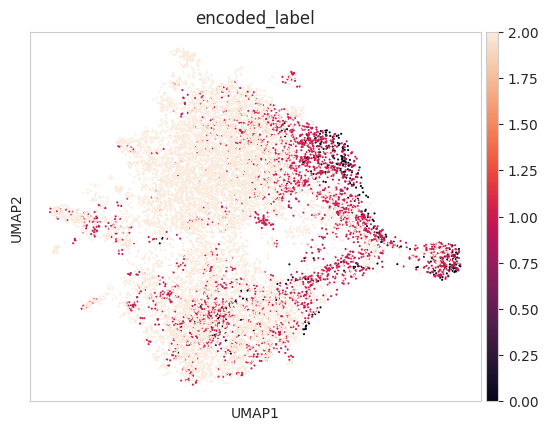

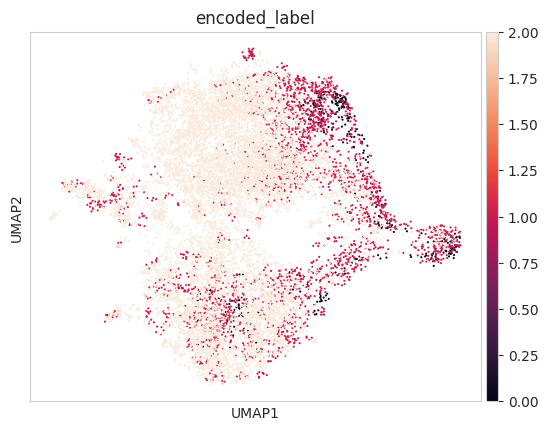

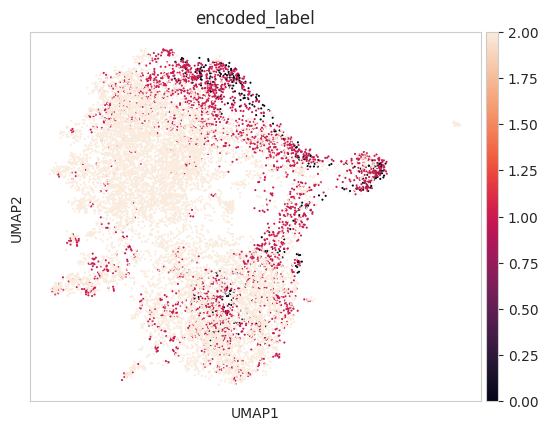

In [52]:
sc.pl.umap(adata_dp_chemberta_scaled, color = "encoded_label")
sc.pl.umap(adata_dp_chemberta_norm, color = "encoded_label")
sc.pl.umap(adata_dp_chemberta, color = "encoded_label")

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


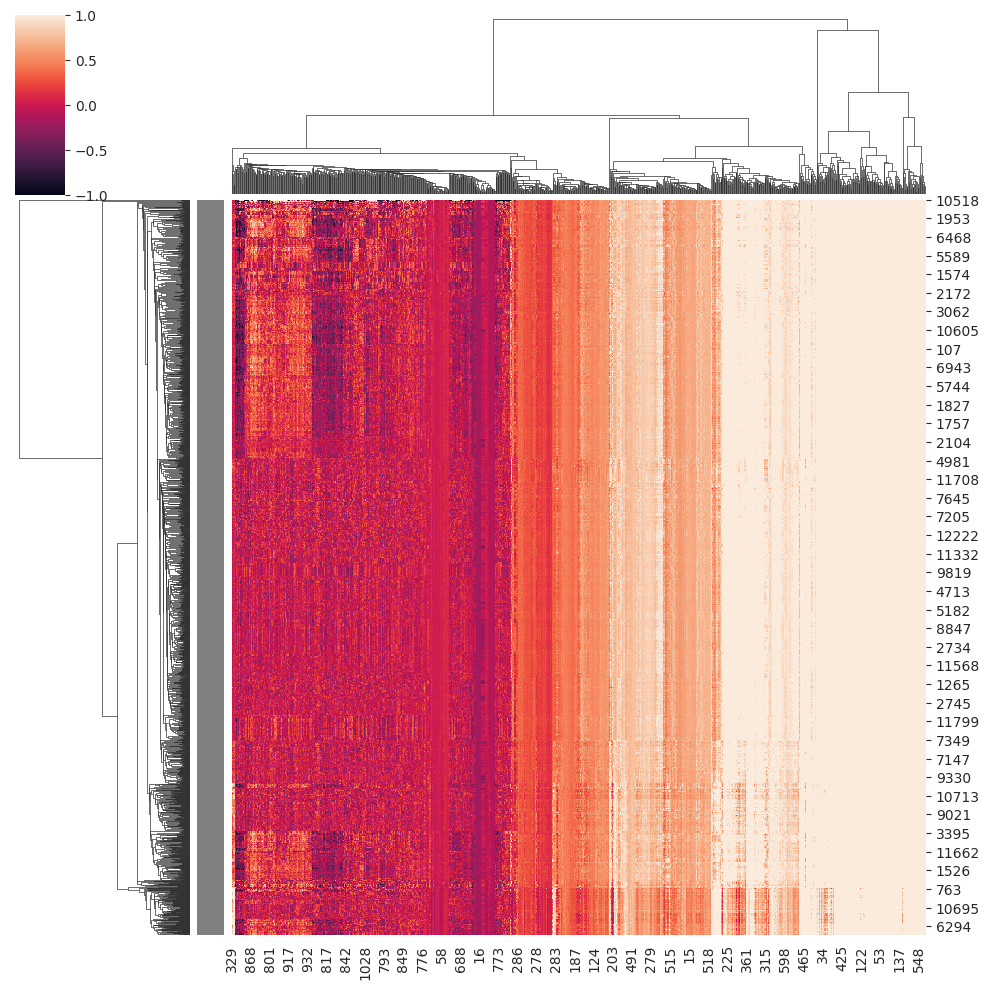

In [53]:
adata_1 = adata_dp_chemberta_norm[adata_dp_chemberta_norm.obs["encoded_label"] == 1]
sc.pl.clustermap(adata_1, obs_keys='batch_id', vmin = -1, vmax =1)

/tmp/ipykernel_95379/821309573.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_1_agg = df.groupby('batch_id').mean().reset_index()
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


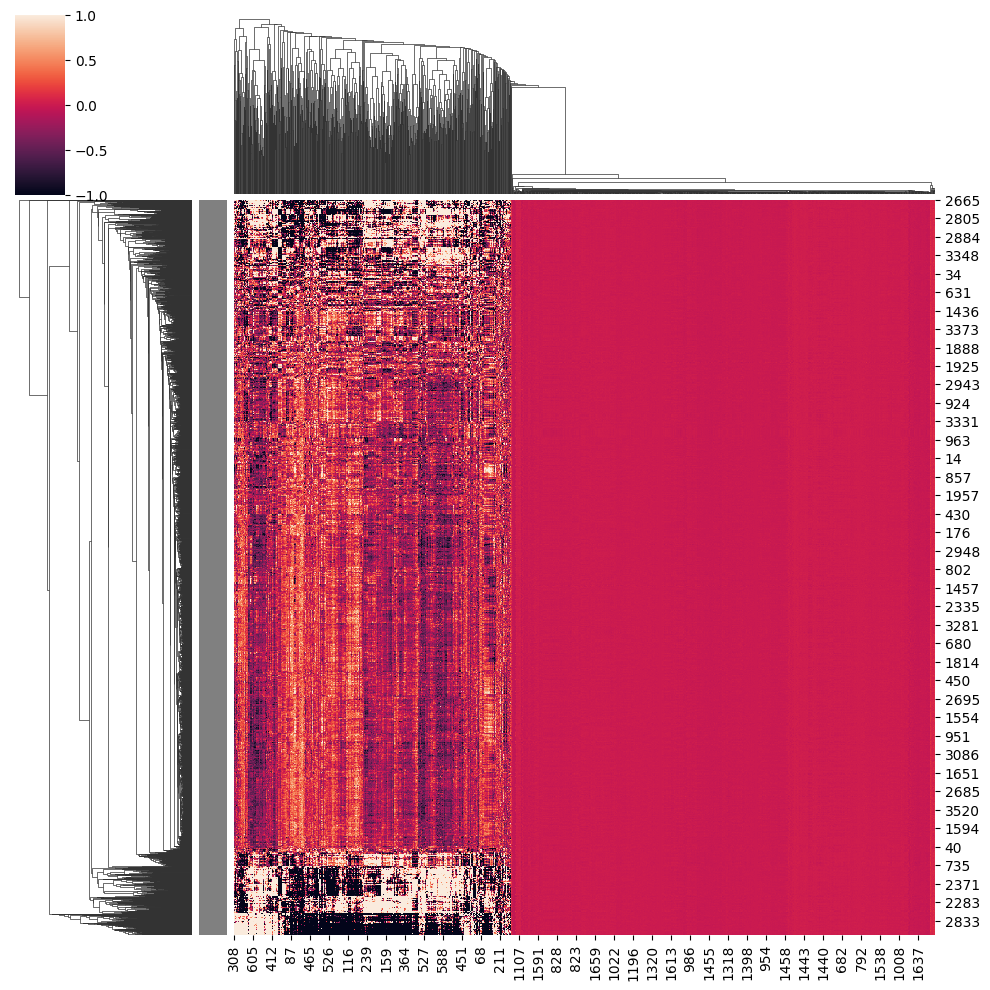

In [88]:
import pandas as pd
import anndata as ad
import scanpy as sc

# Convert AnnData to a DataFrame
df = pd.DataFrame(adata_cp_molt5_scaled.X, index=adata_cp_molt5_scaled.obs_names, columns=adata_cp_molt5_scaled.var_names)

# Add the batch information
df['batch_id'] = adata_cp_molt5_scaled.obs['batch_id']

# Group by batch_id and compute the mean for each feature
adata_1_agg = df.groupby('batch_id').mean().reset_index()

# Extract feature matrix (excluding batch_id)
X_matrix = adata_1_agg.drop(columns=["batch_id"]).values

# Convert batch_id column to DataFrame format
obs_metadata = pd.DataFrame(adata_1_agg["batch_id"], columns=["batch_id"])

# Ensure batch_id is a categorical variable
obs_metadata["batch_id"] = obs_metadata["batch_id"].astype("category")

# Convert back to AnnData
adata_1_agg = ad.AnnData(
    X=X_matrix,
    obs=obs_metadata
)

# Plot Clustermap
sc.pl.clustermap(adata_1_agg, obs_keys="batch_id", vmin=-1, vmax=1)


In [ ]:
import scanpy as sc
import matplotlib.pyplot as plt

adata_dict = {
    'chemberta': adata_chemberta,
    'molt5': adata_molt5,
    'deepprofiler': adata_dp,
    'DP+chemberta': adata_dp_chemberta,
    'DP+molt5': adata_dp_molt5,
    "DP+chemberta scaled": adata_dp_chemberta_scaled,
    "DP+molt5 scaled": adata_dp_molt5_scaled,
    "DP+chemberta norm": adata_dp_chemberta_norm,
    "DP+molt5 norm": adata_dp_molt5_norm,
    "DP+molt5 "
}

colors = ['encoded_label']

# Split datasets: single models in first row, combined models in second row
single_models = {k: v for k, v in adata_dict.items() if "+" not in k}
combined_models = {k: v for k, v in adata_dict.items() if "+" in k}

n_single = len(single_models)
n_combined = len(combined_models)
n_cols = max(n_single, n_combined)  # Ensure the grid width fits the max needed

# Set up figure with two rows: first row for single models, second for combined
fig, axs = plt.subplots(2, n_cols, figsize=(10 * n_cols, 20), dpi = 300)

# Ensure axs is 2D
axs = axs.reshape(2, n_cols)

# Plot UMAPs for single models (first row)
for col_idx, (adata_name, adata_obj) in enumerate(single_models.items()):
    sc.pl.umap(adata_obj, color=colors[0], ax=axs[0, col_idx],size=30, show=False, title=f"{adata_name} - UMAP")
    axs[0, col_idx].set_title(f"{adata_name} - UMAP", fontsize=24, fontweight="bold")
# Plot UMAPs for combined models (second row)
for col_idx, (adata_name, adata_obj) in enumerate(combined_models.items()):
    sc.pl.umap(adata_obj, color=colors[0], ax=axs[1, col_idx], show=False,size=30, title=f"{adata_name} - UMAP")
    axs[1, col_idx].set_title(f"{adata_name} - UMAP", fontsize=24, fontweight="bold")
# Hide any empty subplots in case of uneven numbers
for i in range(n_cols):
    if i >= len(single_models):
        axs[0, i].axis("off")
    if i >= len(combined_models):
        axs[1, i].axis("off")

plt.tight_layout()
plt.show()

# Split data

In [3]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split

def stratified_split_no_batch_overlap(
    adata, 
    label_col="label", 
    batch_col="batch_id", 
    test_size=0.2, 
    val_size=0.1, 
    random_seed=42, 
    obsm_key=None
):
    """
    Splits an AnnData object into train, validation, and test sets in a stratified way
    over the `label_col`, while ensuring that `batch_id` does not overlap between splits.
    Allows selecting a specific `obsm` key instead of `X` for feature extraction.

    Parameters:
        adata (AnnData): The input AnnData object.
        label_col (str): Column in `adata.obs` used for stratification.
        batch_col (str): Column in `adata.obs` that must not overlap between splits.
        test_size (float): Proportion of data to allocate to the test set.
        val_size (float): Proportion of data to allocate to the validation set **from remaining data**.
        random_seed (int): Random seed for reproducibility.
        obsm_key (str, optional): If provided, use this `obsm` key for feature extraction instead of `X`.

    Returns:
        train_df (pd.DataFrame): Train set as a DataFrame with features and labels.
        val_df (pd.DataFrame): Validation set as a DataFrame with features and labels.
        test_df (pd.DataFrame): Test set as a DataFrame with features and labels.
    """

    np.random.seed(random_seed)

    # Convert AnnData to Pandas DataFrame
    obs_df = adata.obs.copy()

    # Use specified `obsm` key if provided, otherwise use `X`
    if obsm_key is not None:
        if obsm_key not in adata.obsm.keys():
            raise ValueError(f"obsm_key '{obsm_key}' not found in AnnData.obsm. Available keys: {list(adata.obsm.keys())}")
        feature_matrix = adata.obsm[obsm_key]
        feature_names = ["Feature_" + str(col) for col in range(feature_matrix.shape[1])]
    else:
        feature_matrix = adata.X.toarray() if hasattr(adata.X, "toarray") else adata.X
        feature_names = ["Feature_" + str(col) for col in adata.var.index]

    # Convert features to a DataFrame
    feature_df = pd.DataFrame(feature_matrix, columns=feature_names, index=adata.obs.index)

    # Merge metadata with feature data
    df = pd.concat([obs_df, feature_df], axis=1)

    # Ensure batch_col and label_col exist
    if batch_col not in df.columns:
        raise ValueError(f"Batch column '{batch_col}' not found in AnnData object.")
    if label_col not in df.columns:
        raise ValueError(f"Label column '{label_col}' not found in AnnData object.")

    # Get unique batch-label combinations
    batch_label_groups = df[[batch_col, label_col]].drop_duplicates()

    # Step 1: Split batch-label groups into test and remaining
    train_groups, test_groups = train_test_split(
        batch_label_groups, stratify=batch_label_groups[label_col], test_size=test_size, random_state=random_seed
    )

    # Step 2: Split remaining into train and validation **properly**
    val_groups, train_groups = train_test_split(
        train_groups, stratify=train_groups[label_col], test_size=1 - (val_size / (1 - test_size)), random_state=random_seed
    )

    # Assign data based on batch-label splits
    train_df = df[df[batch_col].isin(train_groups[batch_col])].reset_index(drop=True)
    val_df = df[df[batch_col].isin(val_groups[batch_col])].reset_index(drop=True)
    test_df = df[df[batch_col].isin(test_groups[batch_col])].reset_index(drop=True)

    return train_df, val_df, test_df



In [34]:
train, val, test = stratified_split_no_batch_overlap(merged_adata,label_col="encoded_label", random_seed = 42, obsm_key= "X_pca")

In [35]:
train = pd.concat([train, val], axis = 0)

In [36]:
train_X = train[[feat for feat in train.columns if "Feature" in feat]]

In [42]:
train_y = train["encoded_label"]

In [43]:
test_X = test[[feat for feat in test.columns if "Feature" in feat]]

In [44]:
test_y = test["encoded_label"]

In [45]:
from sklearn.preprocessing import LabelEncoder

# Encode labels as integers
label_encoder = LabelEncoder()
train_y_encoded = label_encoder.fit_transform(train_y)
test_y_encoded = label_encoder.transform(test_y) 

In [47]:
from sklearn.model_selection import GridSearchCV
def grid_search_rf_xgb(train_X, train_y):
    """Performs Grid Search for Random Forest and XGBoost"""
    # Define parameter grids
    rf_params = {
        'n_estimators': [50, 100, 200],
        'max_depth': [10, 20, None],
        'min_samples_split': [2, 5, 10]
    }

    xgb_params = {
        'n_estimators': [50, 100, 200],
        'max_depth': [3, 6, 10],
        'learning_rate': [0.01, 0.1, 0.2],
        'subsample': [0.8, 1.0]
    }

    # Random Forest Grid Search
    rf = RandomForestClassifier(random_state=42)
    rf_grid = GridSearchCV(rf, rf_params, scoring='f1_weighted', cv=3, n_jobs=-1, verbose=2)
    rf_grid.fit(train_X, train_y)
    best_rf_params = rf_grid.best_params_
    print("Best RF Parameters:", best_rf_params)

    # XGBoost Grid Search
    xgb = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='mlogloss')
    xgb_grid = GridSearchCV(xgb, xgb_params, scoring='f1_weighted', cv=3, n_jobs=-1, verbose=2)
    xgb_grid.fit(train_X, train_y)
    best_xgb_params = xgb_grid.best_params_
    print("Best XGB Parameters:", best_xgb_params)

    return best_rf_params, best_xgb_params

In [48]:
import gc

def print_gpu_memory():
    allocated = torch.cuda.memory_allocated() / (1024**2)
    cached = torch.cuda.memory_reserved() / (1024**2)
    print(f"Allocated: {allocated:.2f} MB")
    print(f"Cached: {cached:.2f} MB")

# Before clearing the cache
print("Before clearing cache:")
print_gpu_memory()

# Clearing cache
gc.collect()
torch.cuda.empty_cache()

# After clearing the cache
print("\nAfter clearing cache:")
print_gpu_memory()

Before clearing cache:
Allocated: 0.00 MB
Cached: 0.00 MB

After clearing cache:
Allocated: 0.00 MB
Cached: 0.00 MB


In [49]:
best_rf_params, best_xgb_params = grid_search_rf_xgb(train_X, train_y_encoded)


Fitting 3 folds for each of 27 candidates, totalling 81 fits


[CV] END .max_depth=10, min_samples_split=2, n_estimators=50; total time=   2.4s
[CV] END .max_depth=10, min_samples_split=2, n_estimators=50; total time=   2.4s
[CV] END .max_depth=10, min_samples_split=2, n_estimators=50; total time=   2.4s
[CV] END max_depth=10, min_samples_split=2, n_estimators=100; total time=   4.8s
[CV] END max_depth=10, min_samples_split=2, n_estimators=100; total time=   4.9s
[CV] END max_depth=10, min_samples_split=2, n_estimators=100; total time=   4.9s
[CV] END .max_depth=10, min_samples_split=5, n_estimators=50; total time=   2.4s
[CV] END .max_depth=10, min_samples_split=5, n_estimators=50; total time=   2.5s
[CV] END .max_depth=10, min_samples_split=5, n_estimators=50; total time=   2.4s
[CV] END max_depth=10, min_samples_split=5, n_estimators=100; total time=   4.8s
[CV] END max_depth=10, min_samples_split=2, n_estimators=200; total time=   9.9s
[CV] END max_depth=10, min_samples_split=5, n_estimators=100; total time=   4.9s
[CV] END max_depth=10, min_s

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/

[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8; total time=   2.4s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8; total time=   2.4s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8; total time=   2.5s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8; total time=   2.5s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8; total time=   2.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/

[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8; total time=   0.9s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.8s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8; total time=   1.7s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8; total time=   1.8s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8; total time=   1.8s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0; total time=   1.7s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=6, n_estimators=50, subsample=0.8; total time=   2.0s
[CV] END learning_rate=0.01, max_depth=6, n_estimators=50, subsample=0.8; total time=   2.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=6, n_estimators=50, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.01, max_depth=6, n_estimators=50, subsample=0.8; total time=   2.1s
[CV] END learning_rate=0.01, max_depth=6, n_estimators=50, subsample=1.0; total time=   2.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=6, n_estimators=50, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, max_depth=6, n_estimators=100, subsample=0.8; total time=   3.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=6, n_estimators=100, subsample=0.8; total time=   4.0s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=6, n_estimators=100, subsample=0.8; total time=   4.0s
[CV] END learning_rate=0.01, max_depth=6, n_estimators=100, subsample=1.0; total time=   4.0s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=6, n_estimators=100, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.01, max_depth=6, n_estimators=100, subsample=1.0; total time=   4.3s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=6, n_estimators=200, subsample=0.8; total time=   7.9s
[CV] END learning_rate=0.01, max_depth=6, n_estimators=200, subsample=0.8; total time=   7.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=6, n_estimators=200, subsample=1.0; total time=   8.1s
[CV] END learning_rate=0.01, max_depth=6, n_estimators=200, subsample=0.8; total time=   8.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=50, subsample=0.8; total time=   7.0s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=50, subsample=0.8; total time=   7.5s
[CV] END learning_rate=0.01, max_depth=6, n_estimators=200, subsample=1.0; total time=   8.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=6, n_estimators=200, subsample=1.0; total time=   8.8s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=50, subsample=0.8; total time=   7.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=50, subsample=1.0; total time=   8.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=50, subsample=1.0; total time=   8.8s
[CV] END learning_rate=0.01, max_depth=10, n_estimators=50, subsample=1.0; total time=   8.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=100, subsample=0.8; total time=  14.7s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=100, subsample=0.8; total time=  15.0s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=100, subsample=0.8; total time=  15.7s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=100, subsample=1.0; total time=  17.4s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=100, subsample=1.0; total time=  15.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8; total time=   0.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8; total time=   0.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8; total time=   0.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0; total time=   0.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0; total time=   0.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=100, subsample=1.0; total time=  17.7s
[CV] END learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0; total time=   0.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8; total time=   0.9s
[CV] END learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8; total time=   0.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8; total time=   0.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:54:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8; total time=   1.6s
[CV] END learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8; total time=   1.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8; total time=   1.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0; total time=   1.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0; total time=   2.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=50, subsample=0.8; total time=   2.2s
[CV] END learning_rate=0.1, max_depth=6, n_estimators=50, subsample=0.8; total time=   2.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=50, subsample=0.8; total time=   2.1s
[CV] END learning_rate=0.1, max_depth=6, n_estimators=50, subsample=1.0; total time=   2.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=50, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, max_depth=6, n_estimators=50, subsample=1.0; total time=   2.3s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=200, subsample=0.8; total time=  31.8s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=200, subsample=0.8; total time=  32.4s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=100, subsample=0.8; total time=   3.9s
[CV] END learning_rate=0.1, max_depth=6, n_estimators=100, subsample=0.8; total time=   4.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=100, subsample=0.8; total time=   4.0s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=100, subsample=1.0; total time=   3.8s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=100, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.1, max_depth=6, n_estimators=100, subsample=1.0; total time=   4.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=200, subsample=0.8; total time=  32.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=200, subsample=1.0; total time=  35.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=200, subsample=0.8; total time=   6.7s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=200, subsample=0.8; total time=   6.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=200, subsample=1.0; total time=  35.7s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=200, subsample=0.8; total time=   6.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=200, subsample=1.0; total time=   7.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=200, subsample=1.0; total time=   6.7s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=10, n_estimators=200, subsample=1.0; total time=  36.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=6, n_estimators=200, subsample=1.0; total time=   6.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=50, subsample=0.8; total time=   7.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=50, subsample=0.8; total time=   7.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=50, subsample=0.8; total time=   7.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=50, subsample=1.0; total time=   7.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=50, subsample=1.0; total time=   7.3s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=50, subsample=1.0; total time=   8.0s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=100, subsample=0.8; total time=  10.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=100, subsample=0.8; total time=  10.3s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=100, subsample=0.8; total time=  10.4s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=100, subsample=1.0; total time=  10.8s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=100, subsample=1.0; total time=  11.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=50, subsample=0.8; total time=   0.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=100, subsample=1.0; total time=  11.7s
[CV] END learning_rate=0.2, max_depth=3, n_estimators=50, subsample=0.8; total time=   0.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=50, subsample=0.8; total time=   0.5s
[CV] END learning_rate=0.2, max_depth=3, n_estimators=50, subsample=1.0; total time=   0.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.2, max_depth=3, n_estimators=50, subsample=1.0; total time=   0.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=100, subsample=0.8; total time=   0.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=100, subsample=0.8; total time=   1.0s
[CV] END learning_rate=0.2, max_depth=3, n_estimators=100, subsample=0.8; total time=   0.9s
[CV] END learning_rate=0.1, max_depth=10, n_estimators=200, subsample=0.8; total time=  13.9s
[CV] END learning_rate=0.2, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.2, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=200, subsample=0.8; total time=   1.8s
[CV] END learning_rate=0.1, max_depth=10, n_estimators=200, subsample=0.8; total time=  14.8s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=200, subsample=0.8; total time=   1.8s
[CV] END learning_rate=0.2, max_depth=3, n_estimators=200, subsample=0.8; total time=   1.8s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, max_depth=10, n_estimators=200, subsample=0.8; total time=  13.5s
[CV] END learning_rate=0.2, max_depth=3, n_estimators=200, subsample=1.0; total time=   1.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=3, n_estimators=200, subsample=1.0; total time=   1.8s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=50, subsample=0.8; total time=   2.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=50, subsample=0.8; total time=   1.9s
[CV] END learning_rate=0.2, max_depth=6, n_estimators=50, subsample=1.0; total time=   1.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=50, subsample=0.8; total time=   2.0s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=50, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, max_depth=10, n_estimators=200, subsample=1.0; total time=  13.7s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=50, subsample=1.0; total time=   2.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=200, subsample=1.0; total time=  13.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=200, subsample=1.0; total time=  14.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=100, subsample=0.8; total time=   3.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=100, subsample=0.8; total time=   3.5s
[CV] END learning_rate=0.2, max_depth=6, n_estimators=100, subsample=0.8; total time=   3.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=100, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.2, max_depth=6, n_estimators=100, subsample=1.0; total time=   3.4s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=100, subsample=1.0; total time=   3.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:55:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=200, subsample=0.8; total time=   5.2s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=200, subsample=0.8; total time=   5.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=200, subsample=0.8; total time=   5.3s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=200, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.2, max_depth=6, n_estimators=200, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=50, subsample=0.8; total time=   4.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=6, n_estimators=200, subsample=1.0; total time=   5.3s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=10, n_estimators=50, subsample=0.8; total time=   5.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=10, n_estimators=50, subsample=0.8; total time=   5.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=10, n_estimators=50, subsample=1.0; total time=   5.5s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=10, n_estimators=50, subsample=1.0; total time=   5.7s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=10, n_estimators=50, subsample=1.0; total time=   5.7s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=10, n_estimators=100, subsample=0.8; total time=   6.9s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=100, subsample=0.8; total time=   6.9s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=10, n_estimators=100, subsample=0.8; total time=   7.1s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=100, subsample=1.0; total time=   6.6s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.2, max_depth=10, n_estimators=100, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=100, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=200, subsample=0.8; total time=   8.1s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=200, subsample=0.8; total time=   8.0s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=200, subsample=0.8; total time=   8.0s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=200, subsample=1.0; total time=   8.0s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=200, subsample=1.0; total time=   8.0s
[CV] END learning_rate=0.2, max_depth=10, n_estimators=200, subsample=1.0; total time=   9.1s


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [16:56:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best XGB Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'subsample': 1.0}


In [55]:
best_rf_params = {'max_depth': None, 'min_samples_split': 5, 'n_estimators': 100}
best_xgb_params = {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'subsample': 1.0}

In [56]:
import os
os.environ["SCIPY_ARRAY_API"] = "1"


In [57]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from tabpfn import TabPFNClassifier
from sklearn.metrics import (
    precision_score, recall_score, f1_score, roc_auc_score
)
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from imblearn.under_sampling import RandomUnderSampler

# Function for stratified splitting with no batch overlap
def stratified_split_no_batch_overlap(
    adata, 
    label_col="label", 
    batch_col="batch_id", 
    test_size=0.2, 
    val_size=0.1, 
    random_seed=42, 
    obsm_key=None
):
    np.random.seed(random_seed)

    obs_df = adata.obs.copy()

    # Use specified `obsm` key if provided, otherwise use `X`
    if obsm_key is not None:
        if obsm_key not in adata.obsm.keys():
            raise ValueError(f"obsm_key '{obsm_key}' not found in AnnData.obsm. Available keys: {list(adata.obsm.keys())}")
        feature_matrix = adata.obsm[obsm_key]
        feature_names = ["Feature_" + str(col) for col in range(feature_matrix.shape[1])]
    else:
        feature_matrix = adata.X.toarray() if hasattr(adata.X, "toarray") else adata.X
        feature_names = ["Feature_" + str(col) for col in adata.var.index]

    feature_df = pd.DataFrame(feature_matrix, columns=feature_names, index=adata.obs.index)
    df = pd.concat([obs_df, feature_df], axis=1)

    if batch_col not in df.columns:
        raise ValueError(f"Batch column '{batch_col}' not found in AnnData object.")
    if label_col not in df.columns:
        raise ValueError(f"Label column '{label_col}' not found in AnnData object.")

    batch_label_groups = df[[batch_col, label_col]].drop_duplicates()

    train_groups, test_groups = train_test_split(
        batch_label_groups, stratify=batch_label_groups[label_col], test_size=test_size, random_state=random_seed
    )

    val_groups, train_groups = train_test_split(
        train_groups, stratify=train_groups[label_col], test_size=1 - (val_size / (1 - test_size)), random_state=random_seed
    )

    train_df = df[df[batch_col].isin(train_groups[batch_col])].reset_index(drop=True)
    val_df = df[df[batch_col].isin(val_groups[batch_col])].reset_index(drop=True)
    test_df = df[df[batch_col].isin(test_groups[batch_col])].reset_index(drop=True)

    return train_df, val_df, test_df

# Training and Evaluation
def evaluate_models(adata, obsm_keys=["X", "X_pca", "X_pca_harmony"], label_col="label", batch_col="batch_id", undersample=False):
    results = []
    predictions = []

    for split_seed in range(5):  # 5 random splits
        for obsm_key in obsm_keys:
            print(f"Evaluating for split seed {split_seed} and features {obsm_key}")

            # Perform stratified split
            train, val, test = stratified_split_no_batch_overlap(
                adata, label_col=label_col, batch_col=batch_col, random_seed=split_seed, obsm_key=obsm_key
            )

            # Combine train and validation sets
            train = pd.concat([train, val], axis=0)

            # Extract features and labels
            train_X = train[[feat for feat in train.columns if "Feature" in feat]]
            train_y = train[label_col]

            test_X = test[[feat for feat in test.columns if "Feature" in feat]]
            test_y = test[label_col]

            # Label encoding
            label_encoder = LabelEncoder()
            train_y_encoded = label_encoder.fit_transform(train_y)
            test_y_encoded = label_encoder.transform(test_y)

            # Optional undersampling
            if undersample:
                class_counts = np.bincount(train_y_encoded)
                min_class_size = max(3 * np.min(class_counts), np.min(class_counts) * 2)
                
                train_balanced_indices = np.hstack([
                    np.random.choice(np.where(train_y_encoded == cls)[0], min(min_class_size, count), replace=False)
                    for cls, count in enumerate(class_counts)
                ])
                
                train_X = train_X.iloc[train_balanced_indices]
                train_y_encoded = train_y_encoded[train_balanced_indices]

            # Define models
            models = {
                'RandomForest': RandomForestClassifier(**best_rf_params, random_state=42),
                'XGBoost': XGBClassifier(**best_xgb_params, random_state=42),
                'TabPFN': TabPFNClassifier(ignore_pretraining_limits=True, random_state=42),
            }

            # Train and evaluate
            for name, model in models.items():
                print(f"Training {name} on {obsm_key}")

                model.fit(train_X, train_y_encoded)

                test_preds = model.predict(test_X)
                test_probs = (
                    model.predict_proba(test_X)[:, 1] if hasattr(model, "predict_proba") and len(label_encoder.classes_) == 2 else None
                )

                test_roc = (
                    roc_auc_score(test_y_encoded, test_probs, multi_class="ovr") if test_probs is not None else None
                )
                test_f1 = f1_score(test_y_encoded, test_preds, average='weighted')
                test_precision = precision_score(test_y_encoded, test_preds, average='weighted')
                test_recall = recall_score(test_y_encoded, test_preds, average='weighted')

                results.append({
                    "Model": name,
                    "Features": obsm_key,
                    "Seed": split_seed,
                    "ROC AUC": test_roc,
                    "Precision": test_precision,
                    "Recall": test_recall,
                    "F1 Score": test_f1,
                })

                # Store predictions
                preds_df = pd.DataFrame({
                    "True Label": test_y,
                    "Predicted Label": label_encoder.inverse_transform(test_preds),
                    "Model": name,
                    "Features": obsm_key,
                    "Seed": split_seed
                })
                predictions.append(preds_df)

    return pd.DataFrame(results), pd.concat(predictions)
    
# Example usage
#results_df, predictions_df = evaluate_models(adata, obsm_keys=["X_pca", "X_pca_harmony"], label_col="label", batch_col="batch_id", undersample = False)
#results_df_under, predictions_df_under = evaluate_models(adata, obsm_keys=["X_pca", "X_pca_harmony"], label_col="label", batch_col="batch_id", undersample = True)

#results_df_filtered, predictions_df_filtered = evaluate_models(adata_filtered, obsm_keys=["X_pca", "X_pca_harmony"], label_col="label", batch_col="batch_id", undersample = False)
#results_df_filtered_under, predictions_df_filtered_under = evaluate_models(adata_filtered, obsm_keys=["X_pca", "X_pca_harmony"], label_col="label", batch_col="batch_id", undersample = True)

results_df_filtered_simple, predictions_df_filtered_simple = evaluate_models(adata_dp_chemberta_norm, obsm_keys=["X_pca"], label_col="encoded_label", batch_col="batch_id", undersample = False)
results_df_filtered_under_simple, predictions_df_filtered_under_simple = evaluate_models(adata_dp_chemberta_norm, obsm_keys=["X_pca"], label_col="encoded_label", batch_col="batch_id", undersample = True)


Evaluating for split seed 0 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/tabpfn/classifier.py:416: UserWarning: Number of samples 10170 is greater than the maximum Number of samples 10000 supported by the model. You may see degraded performance.
  X, y, feature_names_in, n_features_in = validate_Xy_fit(


Evaluating for split seed 1 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/tabpfn/classifier.py:416: UserWarning: Number of samples 10172 is greater than the maximum Number of samples 10000 supported by the model. You may see degraded performance.
  X, y, feature_names_in, n_features_in = validate_Xy_fit(


Evaluating for split seed 2 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/tabpfn/classifier.py:416: UserWarning: Number of samples 10175 is greater than the maximum Number of samples 10000 supported by the model. You may see degraded performance.
  X, y, feature_names_in, n_features_in = validate_Xy_fit(


Evaluating for split seed 3 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/tabpfn/classifier.py:416: UserWarning: Number of samples 10171 is greater than the maximum Number of samples 10000 supported by the model. You may see degraded performance.
  X, y, feature_names_in, n_features_in = validate_Xy_fit(


Evaluating for split seed 4 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/tabpfn/classifier.py:416: UserWarning: Number of samples 10196 is greater than the maximum Number of samples 10000 supported by the model. You may see degraded performance.
  X, y, feature_names_in, n_features_in = validate_Xy_fit(


Evaluating for split seed 0 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca
Evaluating for split seed 1 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca
Evaluating for split seed 2 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca
Evaluating for split seed 3 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca
Evaluating for split seed 4 and features X_pca
Training RandomForest on X_pca
Training XGBoost on X_pca
Training TabPFN on X_pca


In [58]:
def plot_comparison(results_dfs, filtering_levels):
    """
    Plots model performance across different feature sets and filtering levels.

    Parameters:
        results_dfs (list of pd.DataFrame): List of results DataFrames to compare.
        filtering_levels (list of str): Labels for each filtering level.
    """

    # Ensure proper filtering labels
    if len(results_dfs) == 1:
        results_dfs[0]["Filtering"] = filtering_levels[0]
        combined_df = results_dfs[0]
    else:
        combined_df = pd.concat([
            df.assign(Filtering=filtering_levels[i]) for i, df in enumerate(results_dfs)
        ])

    metrics = ["F1 Score", "Accuracy"]
    titles = ["F1 Score", "Accuracy"]

    # Define feature color map
    feature_palette = {
        "Full Features": "C0",
        "X_pca": "C1",
        "X_pca_harmony": "C2"
    }

    # Create figure with subplots per filtering level
    g = sns.catplot(
        data=combined_df,
        x="Model",
        y="F1 Score",
        hue="Features",
        col="Filtering",  # Separate plots for filtering levels
        kind="bar",
        palette=feature_palette,
        height=5, aspect=1.2,
        dodge=True  # Keep feature sets separate
    )

    g.set_axis_labels("Model", "Weighted F1 Score")
    g.set_titles("{col_name}")  # Use filtering level as title
    g.set(ylim=(combined_df["F1 Score"].min() * 0.98, min(1.0, combined_df["F1 Score"].max() * 1.02)))

    # Move legend outside
    plt.legend(title="Features", bbox_to_anchor=(1.02, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

    # Repeat for Accuracy
    k = sns.catplot(
        data=combined_df,
        x="Model",
        y="Recall",
        hue="Features",
        col="Filtering",
        kind="bar",
        palette=feature_palette,
        height=5, aspect=1.2,
        dodge=True
    )

    k.set_axis_labels("Model", "Recall")
    k.set_titles("{col_name}")
    k.set(ylim=(combined_df["Recall"].min() * 0.98, min(1.0, combined_df["Recall"].max() * 1.02)))

    plt.legend(title="Features", bbox_to_anchor=(1.02, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

    t = sns.catplot(
        data=combined_df,
        x="Model",
        y="Precision",
        hue="Features",
        col="Filtering",
        kind="bar",
        palette=feature_palette,
        height=5, aspect=1.2,
        dodge=True
    )

    t.set_axis_labels("Model", "Precision")
    t.set_titles("{col_name}")
    t.set(ylim=(combined_df["Precision"].min() * 0.98, min(1.0, combined_df["Precision"].max() * 1.02)))

    plt.legend(title="Features", bbox_to_anchor=(1.02, 1), loc='upper left')
    plt.tight_layout()
    plt.show()



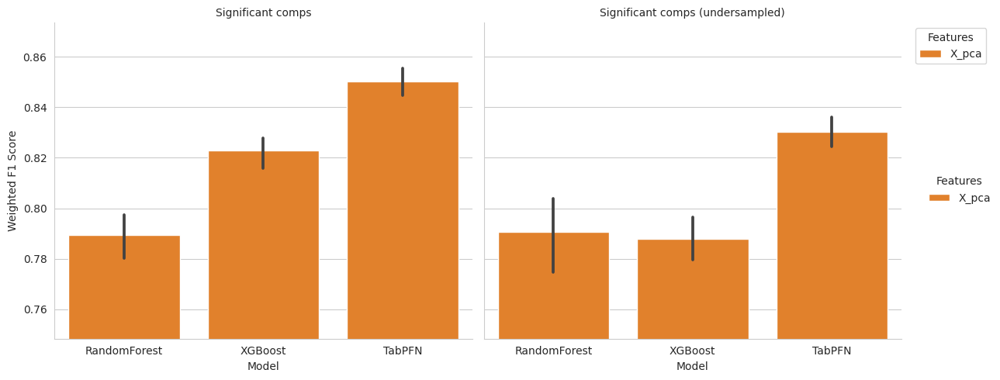

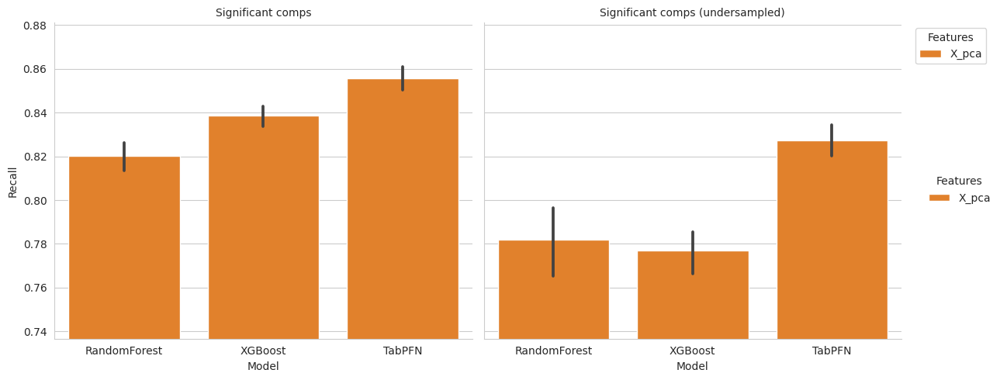

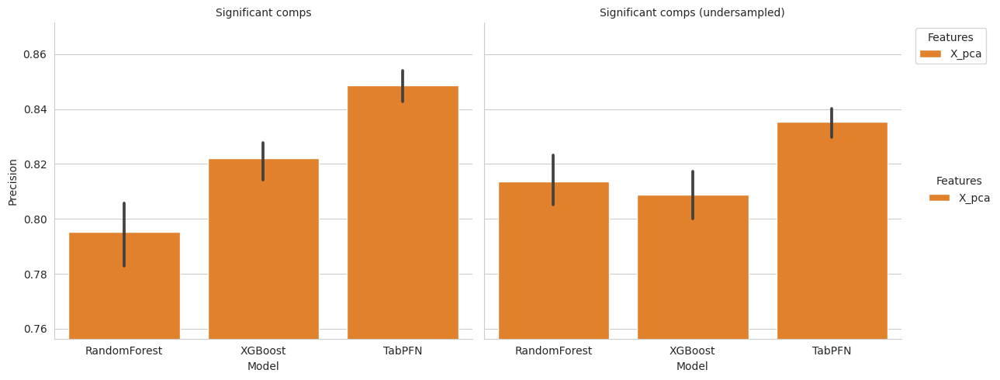

In [59]:
plot_comparison([results_df_filtered_simple, results_df_filtered_under_simple],  ["Significant comps", "Significant comps (undersampled)"])

In [ ]:
results_df_filtered, predictions_df_filtered = evaluate_models(adata_filtered, obsm_keys=["X_pca", "X_pca_harmony"], label_col="label", batch_col="batch_id", undersample = False)
results_df_filtered_under, predictions_df_filtered_under = evaluate_models(adata_filtered, obsm_keys=["X_pca", "X_pca_harmony"], label_col="label", batch_col="batch_id", undersample = True)

In [9]:
from sklearn.metrics import confusion_matrix
def plot_confusion_matrices(predictions):
    """
    Plots confusion matrices averaged over different seeds and reports values as percentages
    with standard deviation annotated as ± in each cell.
    
    Parameters:
        predictions (pd.DataFrame): A DataFrame containing:
            - 'True Label': Actual labels
            - 'Predicted Label': Predicted labels
            - 'Model': Model name
            - 'Features': Feature type used
            - 'Seed': The random seed used in training
    """

    unique_models = predictions["Model"].unique()
    unique_features = predictions["Features"].unique()
    
    for model in unique_models:
        for feature in unique_features:
            subset = predictions[(predictions["Model"] == model) & (predictions["Features"] == feature)]
            if subset.empty:
                continue

            # Get unique labels
            labels = np.unique(np.concatenate([subset["True Label"], subset["Predicted Label"]]))

            # Create confusion matrices for each seed
            seed_matrices = []
            for seed in subset["Seed"].unique():
                seed_subset = subset[subset["Seed"] == seed]
                cm = confusion_matrix(seed_subset["True Label"], seed_subset["Predicted Label"], labels=labels)
                seed_matrices.append(cm)

            # Compute mean and standard deviation confusion matrix across seeds
            mean_cm = np.mean(seed_matrices, axis=0)
            std_cm = np.std(seed_matrices, axis=0)

            # Convert to percentage
            mean_cm_percent = mean_cm / mean_cm.sum(axis=1, keepdims=True) * 100  # Normalize by row sum
            std_cm_percent = std_cm / mean_cm.sum(axis=1, keepdims=True) * 100  # Normalize std by row sum

            # Create formatted annotations with mean ± std
            annotations = np.array([
                [f"{mean_cm_percent[i, j]:.1f}±{std_cm_percent[i, j]:.1f}" for j in range(mean_cm.shape[1])]
                for i in range(mean_cm.shape[0])
            ])

            # Plot confusion matrix with percentages and standard deviation
            plt.figure(figsize=(6, 5))
            ax = sns.heatmap(
                mean_cm_percent, annot=annotations, fmt="", cmap="Blues",
                xticklabels=labels, yticklabels=labels, linewidths=0.5, linecolor="gray"
            )

            plt.xlabel("Predicted Label")
            plt.ylabel("True Label")
            plt.title(f"Confusion Matrix (Mean % ± SD)\n{model} ({feature})")

            plt.show()

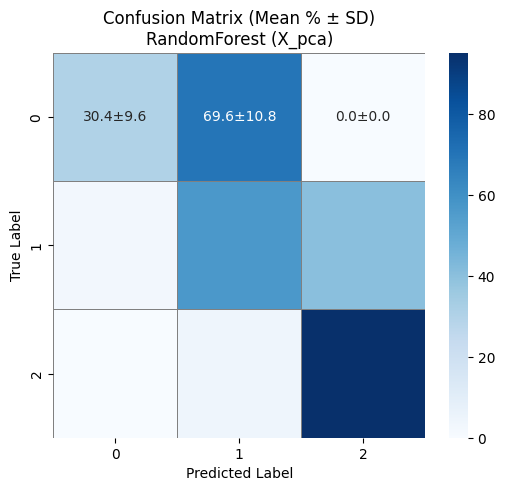

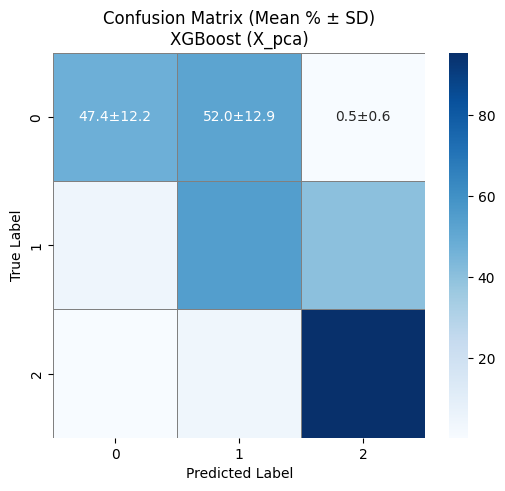

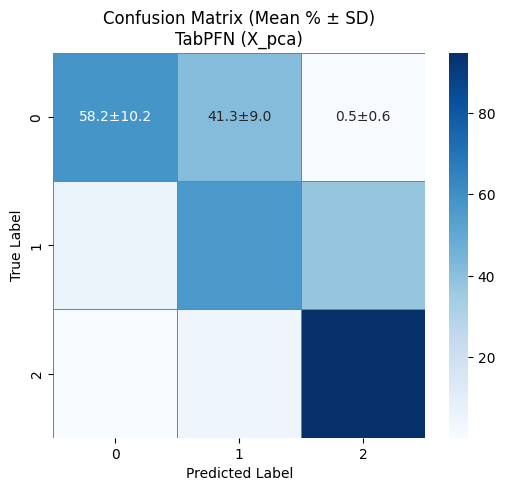

In [10]:
plot_confusion_matrices(predictions_df_filtered_simple)


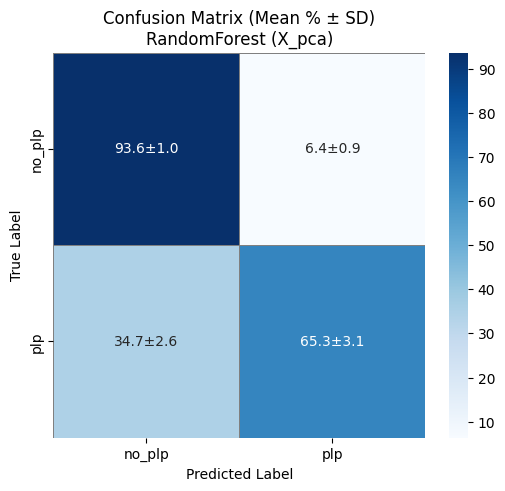

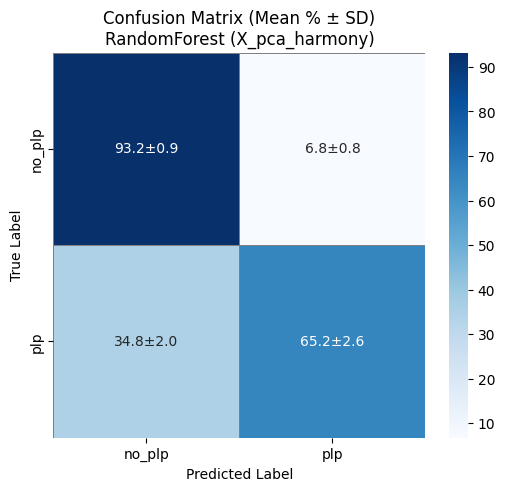

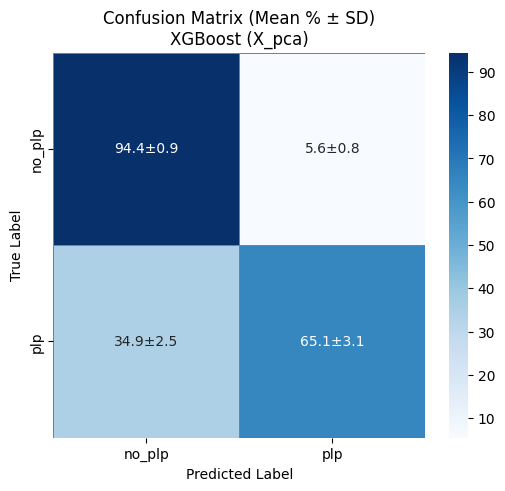

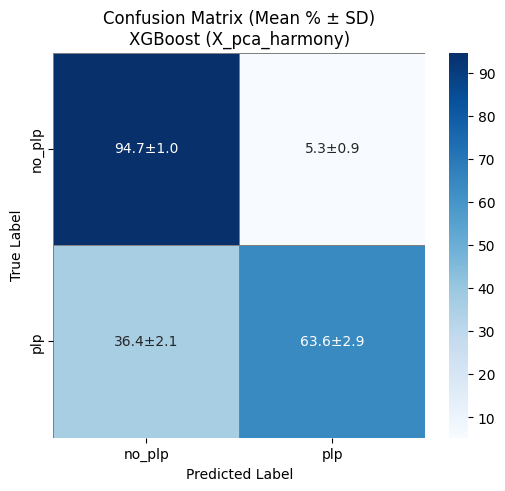

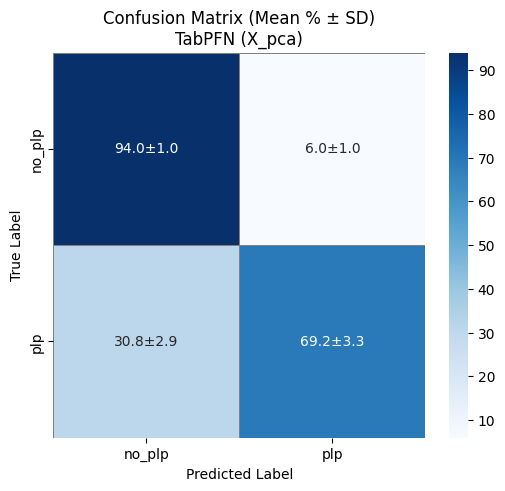

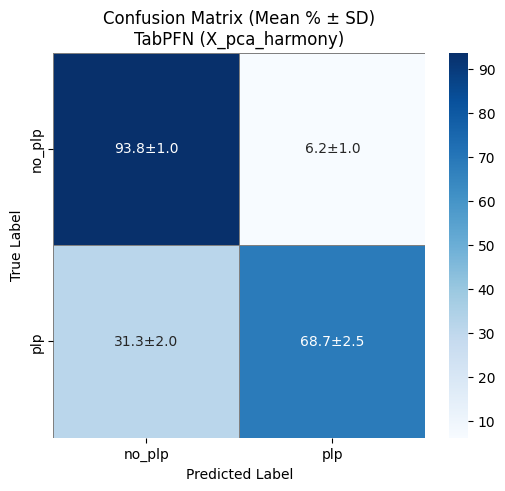

In [64]:
plot_confusion_matrices(predictions_df_filtered_under_simple)


In [2]:
test = ad.read_h5ad("/home/jovyan/share/data/analyses/PLP/DP/specs5k_deepprofiler_siteagg_harmony.h5ad")

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [3]:
test

AnnData object with n_obs × n_vars = 188628 × 672
    obs: 'Metadata_Plate', 'Metadata_Well', 'Metadata_Site', 'Metadata_cmpdName', 'Metadata_cmpdConc', 'Metadata_batch_id', 'row', 'Compound_ID', 'batch_id', '%Induction', 'High_PLP_10uM_>80', 'No_PLP_10uM_<4.53', 'Low_PLP_10uM_between', 'nontoxic_10uM_>80', 'confirmed_in_fix', 'label', 'label_simple', 'label_refined', 'dataset'
    uns: 'dataset_colors', 'label_colors', 'label_simple_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [32]:
from rdkit import Chem
import random

def randomize_smiles(original_smiles: str, verbose: bool = False) -> str:
    """
    Attempts to generate a randomized version of a SMILES string by 
    shuffling atom indices and reconstructing the molecule. Falls back 
    to the original SMILES if any error occurs.

    Parameters:
    - original_smiles (str): The input SMILES string.
    - verbose (bool): If True, prints debug information.

    Returns:
    - str: A randomized SMILES string or the original if something fails.
    """
    try:
        mol = Chem.MolFromSmiles(original_smiles)
        if mol is None:
            if verbose:
                print(f"[Warning] RDKit could not parse SMILES: {original_smiles}")
            return original_smiles
        
        num_atoms = mol.GetNumAtoms()
        if num_atoms < 2:
            if verbose:
                print(f"[Info] Not enough atoms to shuffle in: {original_smiles}")
            return original_smiles

        atom_indices = list(range(num_atoms))
        random.shuffle(atom_indices)
        new_mol = Chem.RenumberAtoms(mol, atom_indices)

        new_smiles = Chem.MolToSmiles(new_mol, canonical=True)
        if not new_smiles:
            if verbose:
                print(f"[Warning] Failed to convert shuffled mol back to SMILES: {original_smiles}")
            return original_smiles

        return new_smiles

    except Exception as e:
        if verbose:
            print(f"[Error] Exception during SMILES randomization: {original_smiles}")
            print(f"        {type(e).__name__}: {e}")
        return original_smiles


In [33]:
randomize_smiles("CC(C)N[C@@H](C)[C@H](O)COc1ccc(C)c2CCCc12")

'Cc1ccc(OC[C@@H](O)[C@H](C)NC(C)C)c2c1CCC2'

In [6]:
smiles = pd.read_csv("/home/jovyan/share/data/analyses/PLP/multimodal/data/deepprofiler_SMILES_minmax_significant.csv")

In [35]:
smiles_list = list(set(list(smiles["SMILES"])))

In [37]:
from rdkit import Chem
import random

count_failed = 0
failed_smiles = []

for smi in smiles_list:
    new_smi = randomize_smiles(smi)
    if new_smi == smi:
        # Means parse or randomization did not succeed in changing it
        count_failed += 1
        failed_smiles.append(smi)

print(f"Number of 'failed' randomizations: {count_failed}")
if failed_smiles:
    print("Examples of SMILES that couldn't be randomized or parse failed:")
    for fs in failed_smiles[:5]:  # show up to 5
        print(" ", fs)


[17:23:51] SMILES Parse Error: syntax error while parsing: O=C([C@H](C(C)C)N(C)C([C@H](CC(C)C)N(C)C([C@H](CC(C)C)N(C)C([C@@H](C)NC([C@H](C)NC([C@H](CC(C)C)N(C)C([C@H](C(C)C)NC([C@H](CC(C)C)N(C)C(CN(C)C([C@H](C(C)C)N1)=O)=O)=O)=O)=O)=O)=O)=O)=O)N(C)[C@@H](C([C
[17:23:51] SMILES Parse Error: check for mistakes around position 200:
[17:23:51] =O)=O)N(C)[C@@H](C([C
[17:23:51] ~~~~~~~~~~~~~~~~~~~~^
[17:23:51] SMILES Parse Error: Failed parsing SMILES 'O=C([C@H](C(C)C)N(C)C([C@H](CC(C)C)N(C)C([C@H](CC(C)C)N(C)C([C@@H](C)NC([C@H](C)NC([C@H](CC(C)C)N(C)C([C@H](C(C)C)NC([C@H](CC(C)C)N(C)C(CN(C)C([C@H](C(C)C)N1)=O)=O)=O)=O)=O)=O)=O)=O)=O)N(C)[C@@H](C([C' for input: 'O=C([C@H](C(C)C)N(C)C([C@H](CC(C)C)N(C)C([C@H](CC(C)C)N(C)C([C@@H](C)NC([C@H](C)NC([C@H](CC(C)C)N(C)C([C@H](C(C)C)NC([C@H](CC(C)C)N(C)C(CN(C)C([C@H](C(C)C)N1)=O)=O)=O)=O)=O)=O)=O)=O)=O)N(C)[C@@H](C([C'
[17:23:51] SMILES Parse Error: syntax error while parsing: C[C@H]1O[C@H](C[C@H](O)[C@@H]1O[C@H]1C[C@H](O)[C@H](O[C@H]2C[C@H](O)[C@H](

Number of 'failed' randomizations: 633
Examples of SMILES that couldn't be randomized or parse failed:
  Oc1ccc(OCc2ccccc2)cc1
  CNCCCCOc1ccccc1Cc1ccccc1
  C[C@H](Nc1ncnc2[nH]cnc12)c1cc2cccc(Cl)c2c(=O)n1-c1ccccc1
  c1ccc(C(O[C@@H]2CCCN(CCc3ccc4c(c3)OCO4)C2)c2ccccc2)cc1
  N=C(N)c1ccc(-c2ccc(-c3ccc(C(=N)N)cc3)o2)cc1


[17:23:53] SMILES Parse Error: Failed parsing SMILES 'ClC1=C(C=CC=C1)N2C(/C=C/C3=NN=C(C4=CC=C(C#N)C=C4)O3)=NN=C2C5=CC=C(S(C)(=O)=O)C=N5.[(E)]' for input: 'ClC1=C(C=CC=C1)N2C(/C=C/C3=NN=C(C4=CC=C(C#N)C=C4)O3)=NN=C2C5=CC=C(S(C)(=O)=O)C=N5.[(E)]'
[17:23:53] SMILES Parse Error: unclosed ring for input: 'CC(C)[C@H]1NC(=O)[C@@H](NC(=O)c2ccc(C)c3oc4c(C)c(=O)c(N)c(C(=O)N[C@H]5[C@@H](C)OC(=O)[C@H](C(C)C)N(C)C(=O)CN(C)C(=O)[C@@H]6CCCN6C(=O)[C@H](NC5=O)C(C)C)c4nc23)[C@@H](C)OC(=O)[C@H](C(C)C)N(C)C(=O)CN(C)C'


In [5]:
imaging_features = pd.read_csv("/home/jovyan/share/data/analyses/PLP/multimodal/data/deepprofiler_features_minmax_significant.csv")

In [8]:
import numpy as np
def augment_tabular_features(
    features: np.ndarray,
    noise_std: float = 0.01,
    col_drop_prob: float = 0.05
) -> np.ndarray:
    """
    Adds mild Gaussian noise and randomly zeroes out some columns.
    features: shape (num_features,)
    noise_std: fraction of row std dev to use for noise scale
    col_drop_prob: probability that a given feature is zeroed out
    """
    feats = features.copy()
    if feats.size == 0:
        return feats  # no features, return as is

    row_std = feats.std() if feats.std() > 1e-8 else 1e-8
    # 1) Add Gaussian noise
    noise = np.random.normal(0, noise_std * row_std, size=feats.shape)
    feats = feats + noise
    # (Optionally clamp if your data should remain in [0,1]):
    # feats = np.clip(feats, 0.0, 1.0)

    # 2) Column dropout
    mask = (np.random.rand(feats.shape[0]) > col_drop_prob).astype(float)
    feats = feats * mask

    return feats

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/da

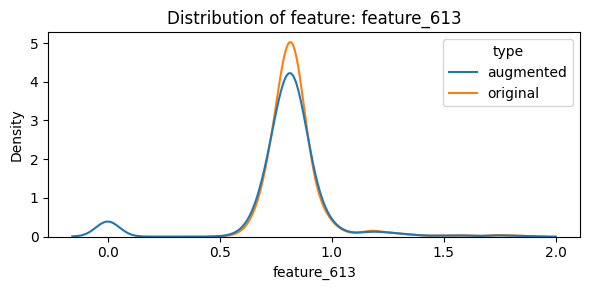

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/da

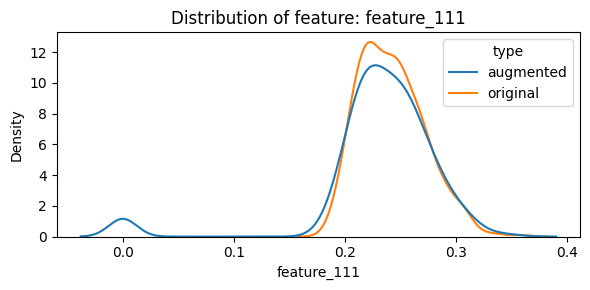

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/da

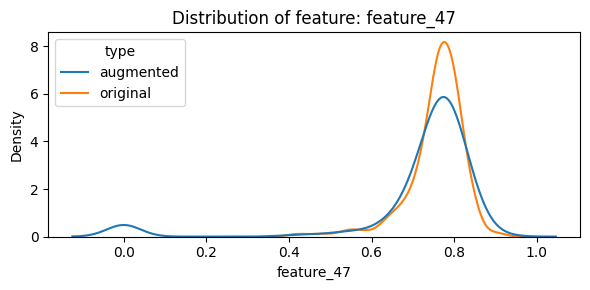

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/da

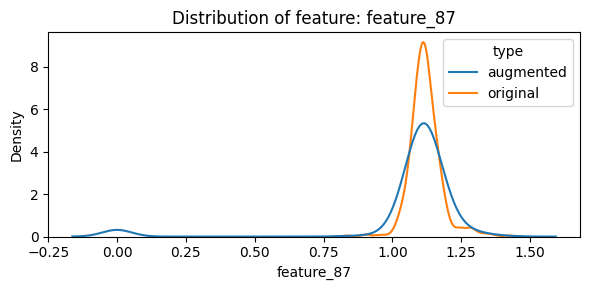

/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/jovyan/share/da

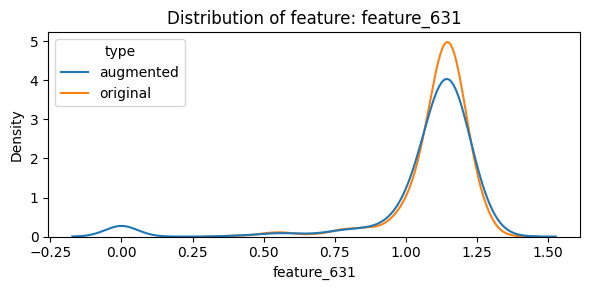

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# Sample multiple rows from the training set
sampled = imaging_features.sample(500)  # Try 50 or more for better stats
img_feat_cols = [feat for feat in imaging_features.columns if "feature" in feat]
augmented_data = []
original_data = []

for _, row in sampled.iterrows():
    original_feat = row[img_feat_cols].values
    original_data.append(original_feat)

    for _ in range(3):  # generate 3 augmentations per sample
        aug = augment_tabular_features(original_feat)
        augmented_data.append(aug)

# Combine
df_aug = pd.DataFrame(augmented_data, columns=img_feat_cols)
df_aug["type"] = "augmented"

df_orig = pd.DataFrame(original_data, columns=img_feat_cols)
df_orig["type"] = "original"

df = pd.concat([df_aug, df_orig], ignore_index=True)

# Plot KDEs for a few random features
import random
for col in random.sample(img_feat_cols, 5):  # sample 5 features
    plt.figure(figsize=(6, 3))
    sns.kdeplot(data=df, x=col, hue="type", common_norm=False)
    plt.title(f"Distribution of feature: {col}")
    plt.tight_layout()
    plt.show()


/home/jovyan/share/data/analyses/PLP/molt5/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


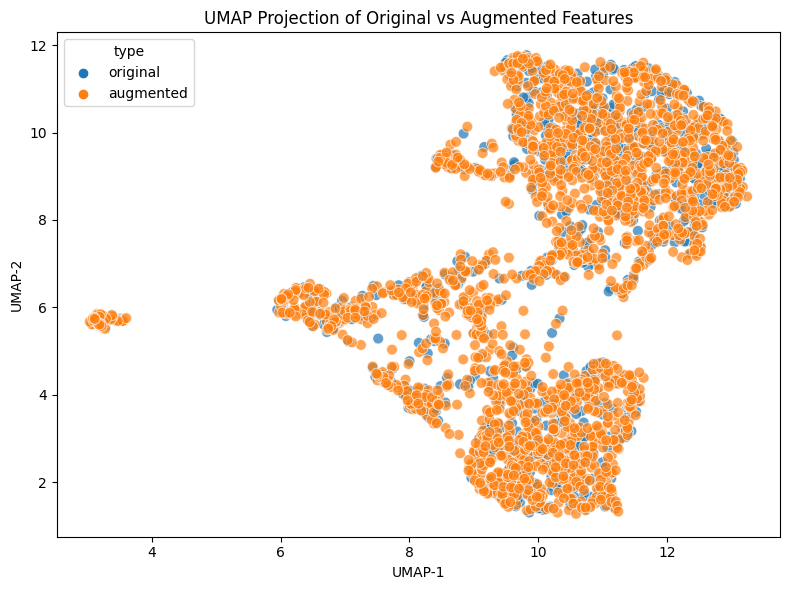

In [13]:
import umap
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Sample a chunk of data from your training set
n_samples = 1000  # or more if your machine can handle it
sampled = imaging_features.sample(n_samples)
img_feat_cols = [feat for feat in imaging_features.columns if "feature" in feat]

augmented_data = []
original_data = []

# Generate 2 augmentations per sample
for _, row in sampled.iterrows():
    original_feat = row[img_feat_cols].values
    original_data.append(original_feat)

    for _ in range(2):
        aug = augment_tabular_features(original_feat)
        augmented_data.append(aug)

# Create DataFrames
df_orig = pd.DataFrame(original_data, columns=img_feat_cols)
df_orig["type"] = "original"

df_aug = pd.DataFrame(augmented_data, columns=img_feat_cols)
df_aug["type"] = "augmented"

df_all = pd.concat([df_orig, df_aug], ignore_index=True)

# UMAP projection
reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(df_all[img_feat_cols].values)

# Plot
df_all["UMAP-1"] = embedding[:, 0]
df_all["UMAP-2"] = embedding[:, 1]

plt.figure(figsize=(8, 6))
sns.scatterplot(data=df_all, x="UMAP-1", y="UMAP-2", hue="type", alpha=0.7, s=60)
plt.title("UMAP Projection of Original vs Augmented Features")
plt.tight_layout()
plt.show()
